# Car Plate Recognition with YOLOv11
This notebook implements a deep learning-based computer vision system for automatic license plate detection using YOLOv11. The project processes images and videos to detect license plates, leveraging Python, OpenCV, and the Ultralytics YOLO library. An interactive Streamlit app is also available for user-friendly detection.

## Project Overview

This project detects vehicle license plates in images and videos using the YOLOv11 model, trained on a Roboflow dataset. Key features include:

- Real-time detection with high precision (0.976) and recall (0.961).
- Support for image and video inputs.
- Integration with a Streamlit app for interactive visualization.
- Video output processing with FFmpeg for format conversion.


## Environment Setup

This code block sets up the Google Colab environment for license plate detection using YOLOv11. It installs the roboflow library to download the License Plate Recognition dataset, torch with CUDA support for GPU acceleration, and ultralytics for the YOLOv11 model. Run the cell to prepare the dependencies and dataset.

In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="ZT1IUdh6iFlDQDEE0qdG")
project = rf.workspace("amr10w").project("license-plate-recognition-rxg4e-vkkdq")
version = project.version(1)
dataset = version.download("yolov11")

loading Roboflow workspace...
loading Roboflow project...


In [ ]:
!pip install torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu121
!pip install Ultralytics

Looking in indexes: https://download.pytorch.org/whl/cu121
INFO: pip is looking at multiple versions of torch to determine which version is compatible with other requirements. This could take a while.
  Using cached https://download.pytorch.org/whl/cu121/torch-2.5.1%2Bcu121-cp311-cp311-linux_x86_64.whl (780.5 MB)
  Using cached https://download.pytorch.org/whl/cu121/nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached https://download.pytorch.org/whl/cu121/nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached https://download.pytorch.org/whl/cu121/nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached https://download.pytorch.org/whl/cu121/nvidia_cudnn_cu12-9.1.0.70-py3-none-manylinux2014_x86_64.whl (664.8 MB)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 410.6/410.6 MB 2.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 121.6/121.6 MB 7.7 MB/s eta 0:00:00
     ━━━━━━━━━━

## Train the model

In [ ]:
from ctypes import BigEndianStructure
from ultralytics import YOLO

# Load a model
model = YOLO("yolo11n.pt")

# Train the model
train_results = model.train(
    data="/content/License-Plate-Recognition-4/data.yaml",
    epochs=15,
    imgsz=640,
    batch=32
)

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


100%|██████████| 5.35M/5.35M [00:00<00:00, 59.1MB/s]


Ultralytics 8.3.169 🚀 Python-3.11.13 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=32, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/License-Plate-Recognition-4/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=15, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True, pos

100%|██████████| 755k/755k [00:00<00:00, 14.1MB/s]

Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      6640  ultralytics.nn.modules.block.C3k2            [32, 64, 1, False, 0.25]      
  3                  -1  1     36992  ultralytics.nn.modules.conv.Conv             [64, 64, 3, 2]                
  4                  -1  1     26080  ultralytics.nn.modules.block.C3k2            [64, 128, 1, False, 0.25]     
  5                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]              
  6                  -1  1     87040  ultralytics.nn.modules.block.C3k2            [128, 128, 1, True]           
  7                  -1  1    295424  ultralytics

 23        [16, 19, 22]  1    430867  ultralytics.nn.modules.head.Detect           [1, [64, 128, 256]]           
YOLO11n summary: 181 layers, 2,590,035 parameters, 2,590,019 gradients, 6.4 GFLOPs

Transferred 448/499 items from pretrained weights
Freezing layer 'model.23.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks...
AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.0±0.0 ms, read: 17.1±3.8 MB/s, size: 43.7 KB)


train: Scanning /content/License-Plate-Recognition-4/train/labels... 21173 images, 28 backgrounds, 0 corrupt: 100%|██████████| 21173/21173 [00:25<00:00, 833.71it/s]


train: New cache created: /content/License-Plate-Recognition-4/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 9.5±3.9 MB/s, size: 35.9 KB)


val: Scanning /content/License-Plate-Recognition-4/valid/labels... 2046 images, 3 backgrounds, 0 corrupt: 100%|██████████| 2046/2046 [00:03<00:00, 657.51it/s]

val: New cache created: /content/License-Plate-Recognition-4/valid/labels.cache


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 15 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/15      4.69G      1.262      1.465      1.208         29        640: 100%|██████████| 662/662 [05:59<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:18<00:00,  1.76it/s]


                   all       2046       2132      0.898      0.837        0.9      0.549

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/15      5.45G      1.274     0.8197      1.245         30        640: 100%|██████████| 662/662 [05:44<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:16<00:00,  1.93it/s]

                   all       2046       2132       0.95        0.9      0.948      0.592



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/15      5.46G      1.242     0.7552      1.232         35        640: 100%|██████████| 662/662 [05:41<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:15<00:00,  2.01it/s]

                   all       2046       2132      0.947      0.852      0.902      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/15      5.46G       1.23     0.7177      1.224         42        640: 100%|██████████| 662/662 [05:43<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:19<00:00,  1.67it/s]

                   all       2046       2132      0.951      0.914      0.954      0.613



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/15      5.46G      1.191     0.6708      1.204         37        640: 100%|██████████| 662/662 [06:00<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:15<00:00,  2.07it/s]

                   all       2046       2132      0.965      0.918       0.96      0.632


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/15      5.46G      1.159     0.5758      1.212         21        640: 100%|██████████| 662/662 [05:28<00:00,  2.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:15<00:00,  2.04it/s]

                   all       2046       2132      0.968      0.934      0.967      0.625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/15      5.46G      1.131     0.5438      1.201         23        640: 100%|██████████| 662/662 [05:23<00:00,  2.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:16<00:00,  1.96it/s]

                   all       2046       2132      0.956      0.935      0.968      0.631



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/15      5.46G      1.106     0.5152      1.184         23        640: 100%|██████████| 662/662 [05:23<00:00,  2.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:15<00:00,  2.04it/s]

                   all       2046       2132      0.965      0.937       0.97      0.637



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/15      5.46G      1.089     0.4914      1.171         21        640: 100%|██████████| 662/662 [05:25<00:00,  2.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:16<00:00,  1.95it/s]

                   all       2046       2132      0.976      0.941      0.973      0.655



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/15      5.46G      1.068     0.4713      1.164         21        640: 100%|██████████| 662/662 [05:24<00:00,  2.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:15<00:00,  2.09it/s]

                   all       2046       2132       0.98      0.944      0.976       0.68



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/15      5.46G      1.052     0.4539      1.153         23        640: 100%|██████████| 662/662 [05:24<00:00,  2.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:16<00:00,  1.97it/s]

                   all       2046       2132      0.977      0.942      0.976      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/15      5.46G      1.035     0.4372      1.148         21        640: 100%|██████████| 662/662 [05:24<00:00,  2.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:15<00:00,  2.08it/s]

                   all       2046       2132      0.971      0.957      0.979      0.681



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/15      5.46G      1.018     0.4202      1.133         21        640: 100%|██████████| 662/662 [05:22<00:00,  2.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:15<00:00,  2.11it/s]

                   all       2046       2132      0.981      0.954      0.982      0.692



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/15      5.46G     0.9999     0.4048      1.127         22        640: 100%|██████████| 662/662 [05:22<00:00,  2.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:16<00:00,  1.92it/s]

                   all       2046       2132      0.976       0.96      0.982      0.693



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/15      5.46G     0.9805     0.3915      1.112         23        640: 100%|██████████| 662/662 [05:24<00:00,  2.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:15<00:00,  2.07it/s]

                   all       2046       2132      0.976      0.961      0.983      0.701



15 epochs completed in 1.457 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/train/weights/best.pt, 5.5MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.169 🚀 Python-3.11.13 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,347 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:19<00:00,  1.62it/s]


                   all       2046       2132      0.976      0.961      0.982      0.701
Speed: 0.2ms preprocess, 2.4ms inference, 0.0ms loss, 2.7ms postprocess per image
Results saved to runs/detect/train


## Visualizing YOLO Training Performance

In [ ]:
import os

path = '/content/runs/detect/train'
l = os.listdir(path)
print(l)

['confusion_matrix_normalized.png', 'BoxPR_curve.png', 'val_batch0_pred.jpg', 'BoxP_curve.png', 'labels_correlogram.jpg', 'BoxR_curve.png', 'val_batch2_pred.jpg', 'val_batch1_labels.jpg', 'train_batch1.jpg', 'args.yaml', 'labels.jpg', 'results.csv', 'val_batch0_labels.jpg', 'train_batch2.jpg', 'train_batch0.jpg', 'weights', 'results.png', 'train_batch3310.jpg', 'confusion_matrix.png', 'train_batch3312.jpg', 'train_batch3311.jpg', 'val_batch1_pred.jpg', 'BoxF1_curve.png', 'val_batch2_labels.jpg']


In [ ]:
plot_files = [
    'BoxPR_curve.png',
    'BoxF1_curve.png',
    'BoxP_curve.png',
    'BoxR_curve.png',
    'confusion_matrix.png',
    'results.png',
    'val_batch0_pred.jpg',
    'val_batch1_pred.jpg',
    'val_batch2_pred.jpg',
]

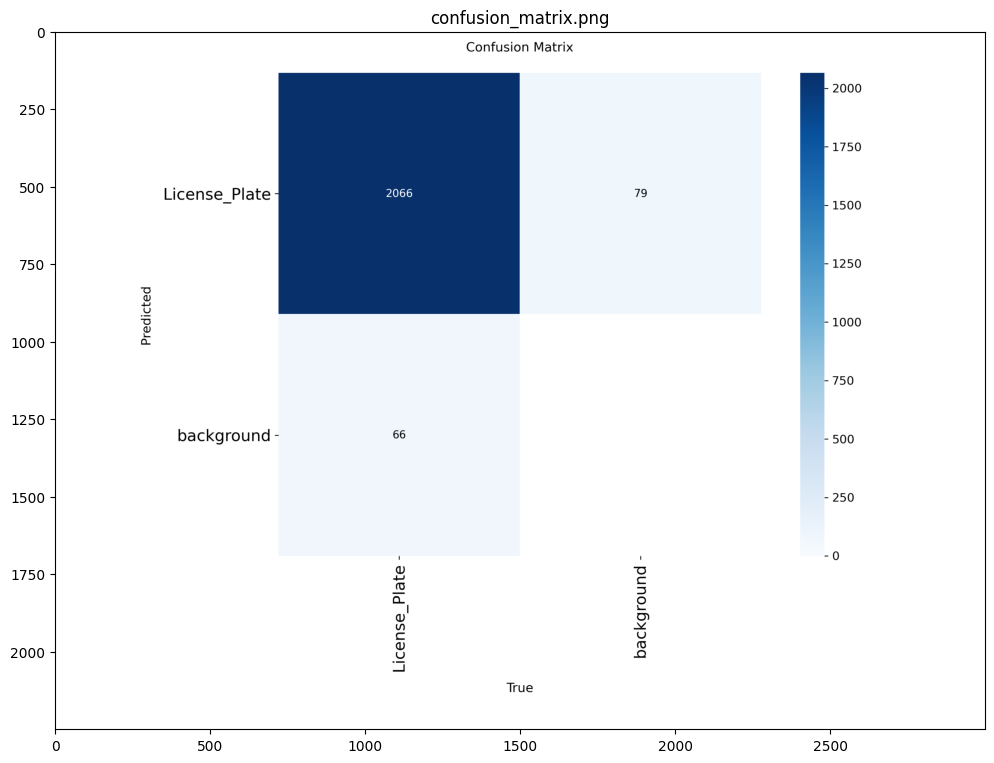

In [ ]:
import matplotlib.pyplot as plt
import cv2
file=plot_files[4]
file_path= os.path.join(path, file)
if os.path.exists(file_path):
    img = cv2.imread(file_path, cv2.IMREAD_UNCHANGED)
    plt.figure(figsize=(12, 10))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title(file)

plt.show()

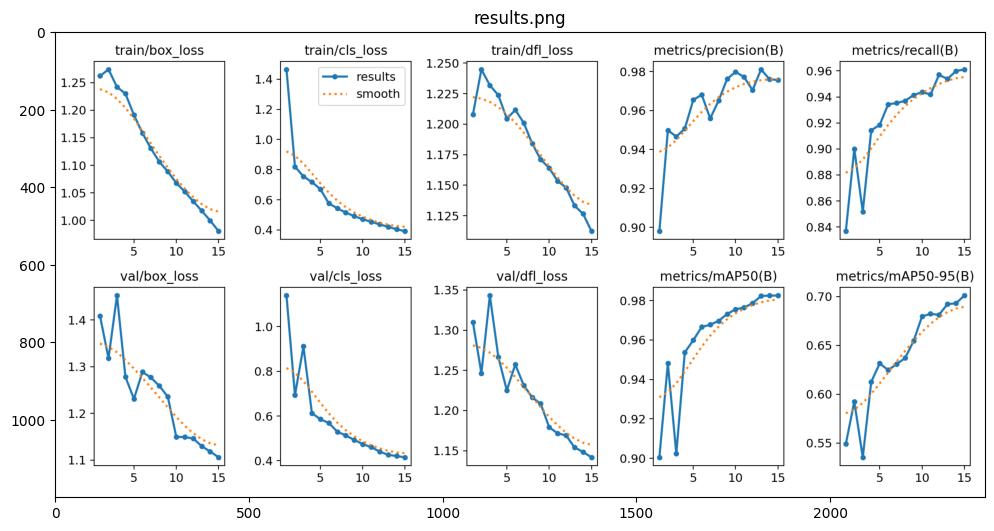

In [ ]:
import matplotlib.pyplot as plt
import cv2
file=plot_files[-4]
file_path= os.path.join(path, file)
if os.path.exists(file_path):
    img = cv2.imread(file_path, cv2.IMREAD_UNCHANGED)
    plt.figure(figsize=(12, 10))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title(file)

plt.show()

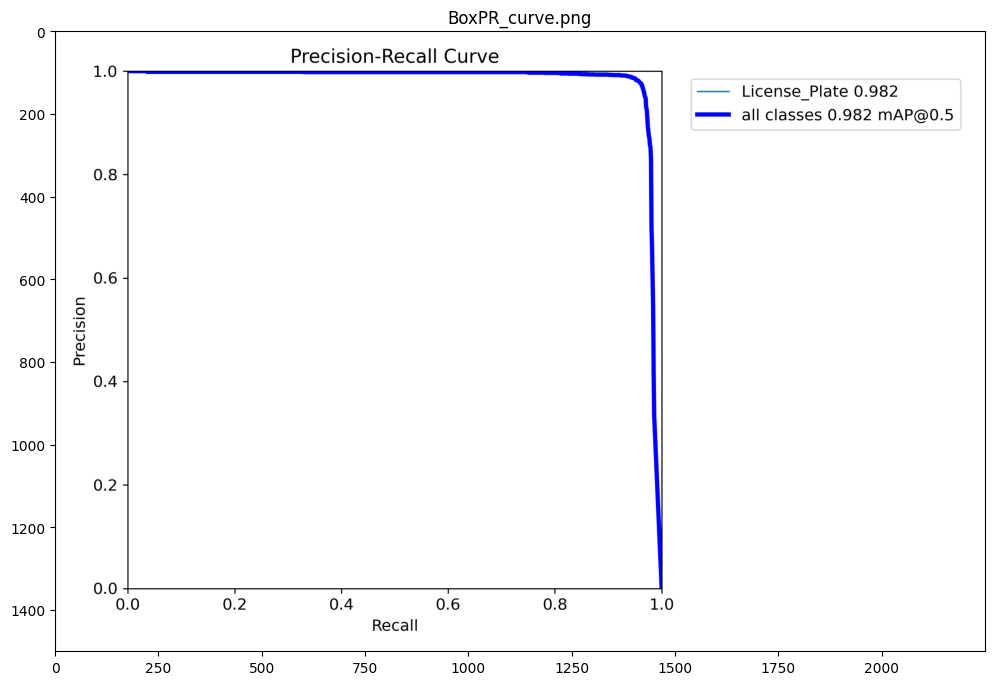

In [ ]:
import matplotlib.pyplot as plt
import cv2
file=plot_files[0]
file_path= os.path.join(path, file)
if os.path.exists(file_path):
    img = cv2.imread(file_path, cv2.IMREAD_UNCHANGED)
    plt.figure(figsize=(12, 10))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title(file)

plt.show()

## Visualize Validation Images

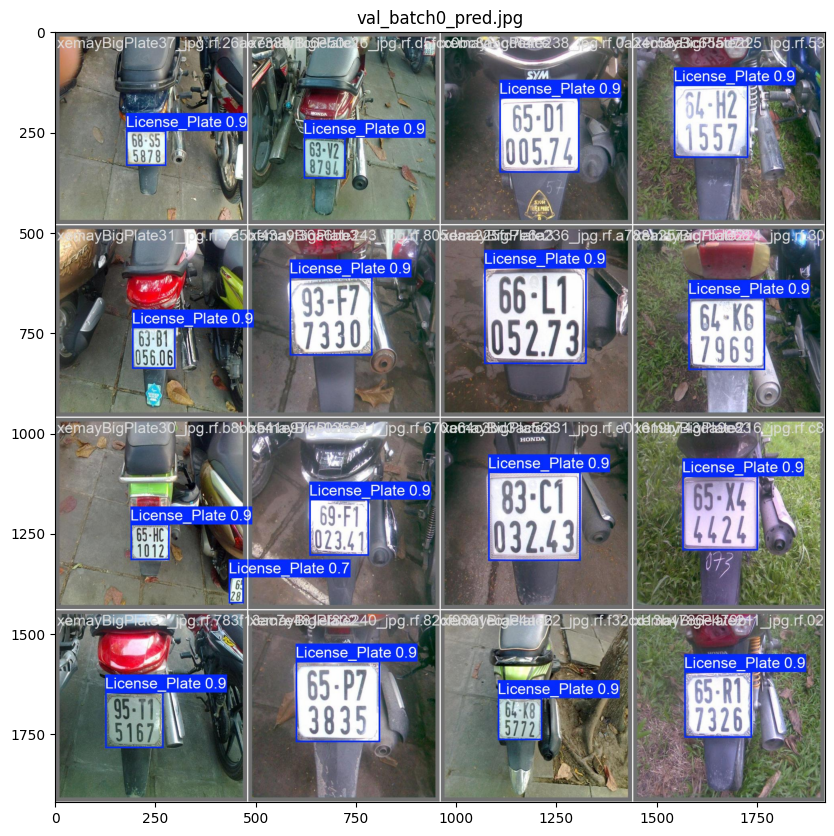

In [ ]:
import matplotlib.pyplot as plt
import cv2
file=plot_files[-3]
file_path= os.path.join(path, file)
if os.path.exists(file_path):
    img = cv2.imread(file_path, cv2.IMREAD_UNCHANGED)
    plt.figure(figsize=(12, 10))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title(file)

plt.show()

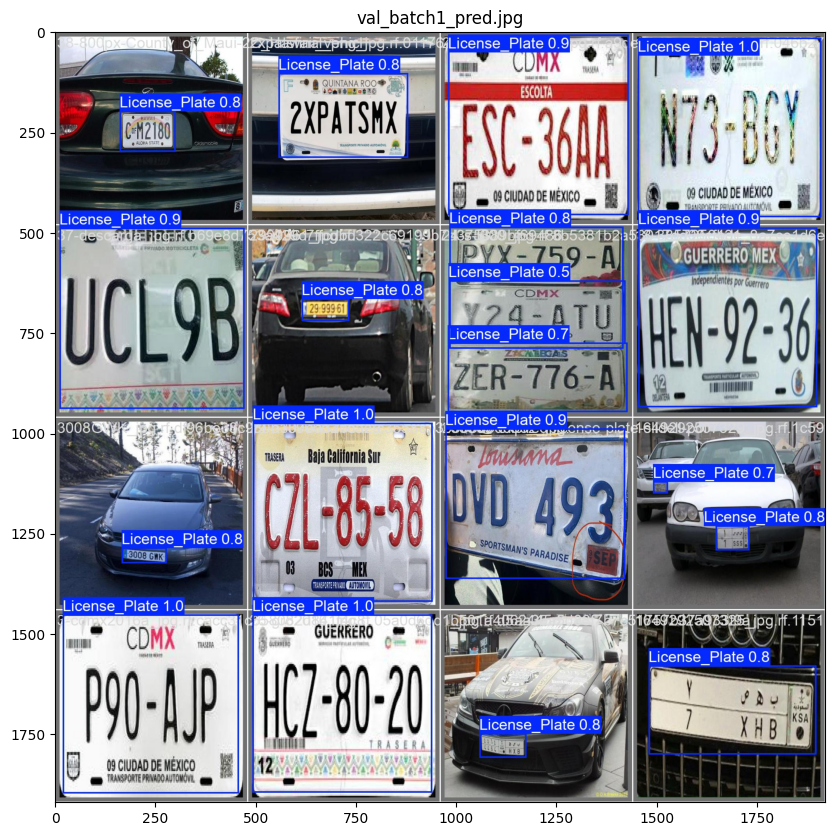

In [ ]:
import matplotlib.pyplot as plt
import cv2
file=plot_files[-2]
file_path= os.path.join(path, file)
if os.path.exists(file_path):
    img = cv2.imread(file_path, cv2.IMREAD_UNCHANGED)
    plt.figure(figsize=(12, 10))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title(file)

plt.show()

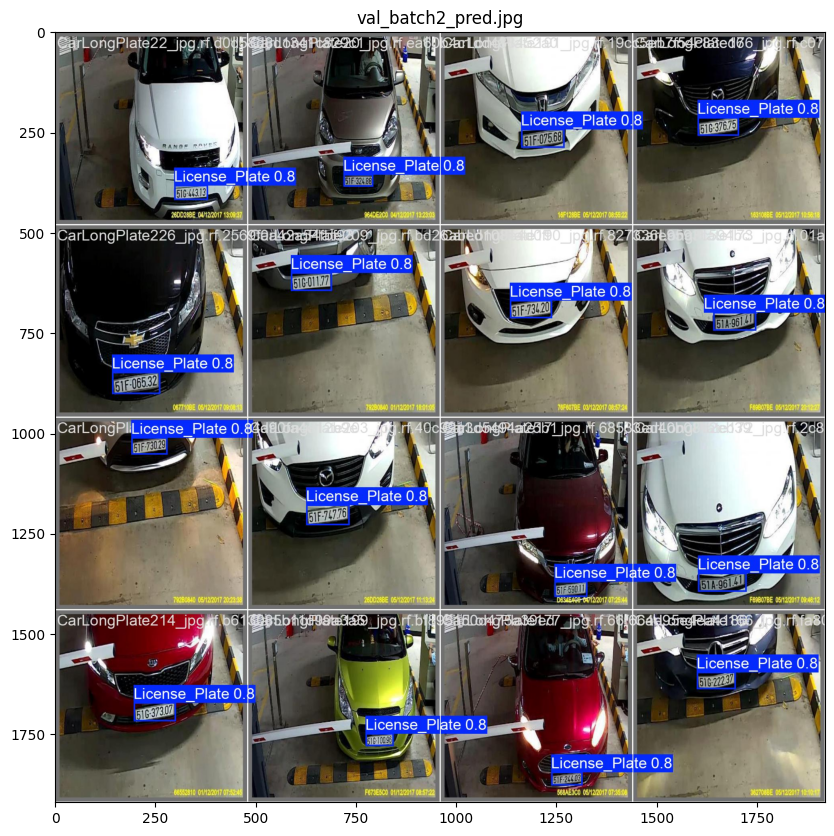

In [ ]:
import matplotlib.pyplot as plt
import cv2
file=plot_files[-1]
file_path= os.path.join(path, file)
if os.path.exists(file_path):
    img = cv2.imread(file_path, cv2.IMREAD_UNCHANGED)
    plt.figure(figsize=(12, 10))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title(file)

plt.show()

## Model Testing

In [ ]:
results = model.predict(
    source=f"/content/License-Plate-Recognition-4/test/images",
    conf=0.5,
    save=True,
    project="runs/detect",
    name="test"
)


WARNING ⚠️ 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

image 1/1019 /content/License-Plate-Recognition-4/test/images/0002a5b67e5f0909_jpg.rf.07ca41e79eb878b14032f650f34d0967.jpg: 640x640 2 License_Plates, 23.8ms
image 2/1019 /content/License-Plate-Recognition-4/test/images/000812dcf304a8e7_jpg.rf.559f904bc045f68ee947796a1b561d8f.jpg: 640x640 1 License_Plate, 36.8ms
image 3/1019 /content/License-Plate-Recognition-4/test/images/0010f4c10f7ab07e_jpg.rf.92344aa620e23aacc490273e32343595.jpg: 640x640 1 License_P

In [ ]:
path = '/content/runs/detect/test'
l = os.listdir(path)
print(l)

['CarLongPlate926_jpg.rf.72a67fc7b746e6b81b50edc727ebf259.jpg', 'CarLongPlateGen1025_jpg.rf.0b31dcd3414bfa0b1d05568d77bfbd1d.jpg', 'images8_jpg.rf.0f63e2d6bf9b0c6188cd09568e7d830c.jpg', '1649292507325_jpg.rf.1dd862911958ea73a2c97fcb6b60da2c.jpg', 'Cars85_png_jpg.rf.940e55b018ec8dc10c70df891781dbbc.jpg', 'CarLongPlateGen3507_jpg.rf.387621eb883058f8d223779bfd92b9e3.jpg', 'xemay1773_jpg.rf.e1419a8a000ca7f5397bf71dab2dc288.jpg', 'xemay842_jpg.rf.9fce91253a1115b773adb87cd5e61948.jpg', 'CarLongPlateGen30_jpg.rf.15a1c7f822b7fdf5b83040b0c949b0bc.jpg', 'xemay818_jpg.rf.a767ba0231e65b208a48071e596282ac.jpg', 'CarLongPlateGen2183_jpg.rf.4e5f51ebabc3dad22392a36b820fad39.jpg', 'CarLongPlateGen501_jpg.rf.fb66b668dd4a8df12c7eb32b442e079c.jpg', 'CarLongPlateGen2353_jpg.rf.c5bf39210fe186425e4538c3d2e8eba8.jpg', 'CarLongPlateGen2651_jpg.rf.f9aaa84ef59eeeba0f259126adc7d78b.jpg', 'CarLongPlateGen146_jpg.rf.331c76844d3f1a4d30a971f980ec8186.jpg', 'CarLongPlateGen1561_jpg.rf.5ba0b17a48044409629617d05d19a2bf.

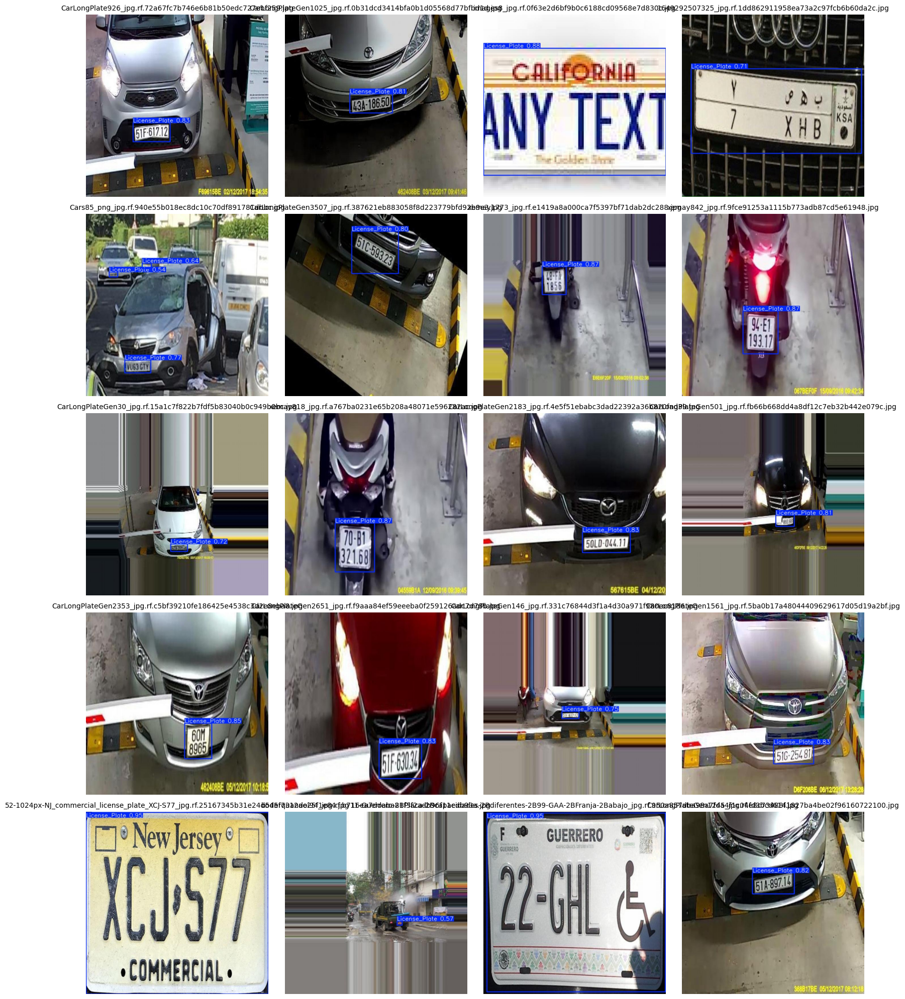

In [ ]:
rows, cols = 5, 4
plt.figure(figsize=(16, 20))

image_files = [f for f in os.listdir(path) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

for i in range(min(rows * cols, len(image_files))):
    img_path = os.path.join(path, image_files[i])
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    plt.subplot(rows, cols, i + 1)
    plt.imshow(img)
    plt.title(image_files[i], fontsize=10)
    plt.axis('off')

plt.tight_layout()
plt.show()

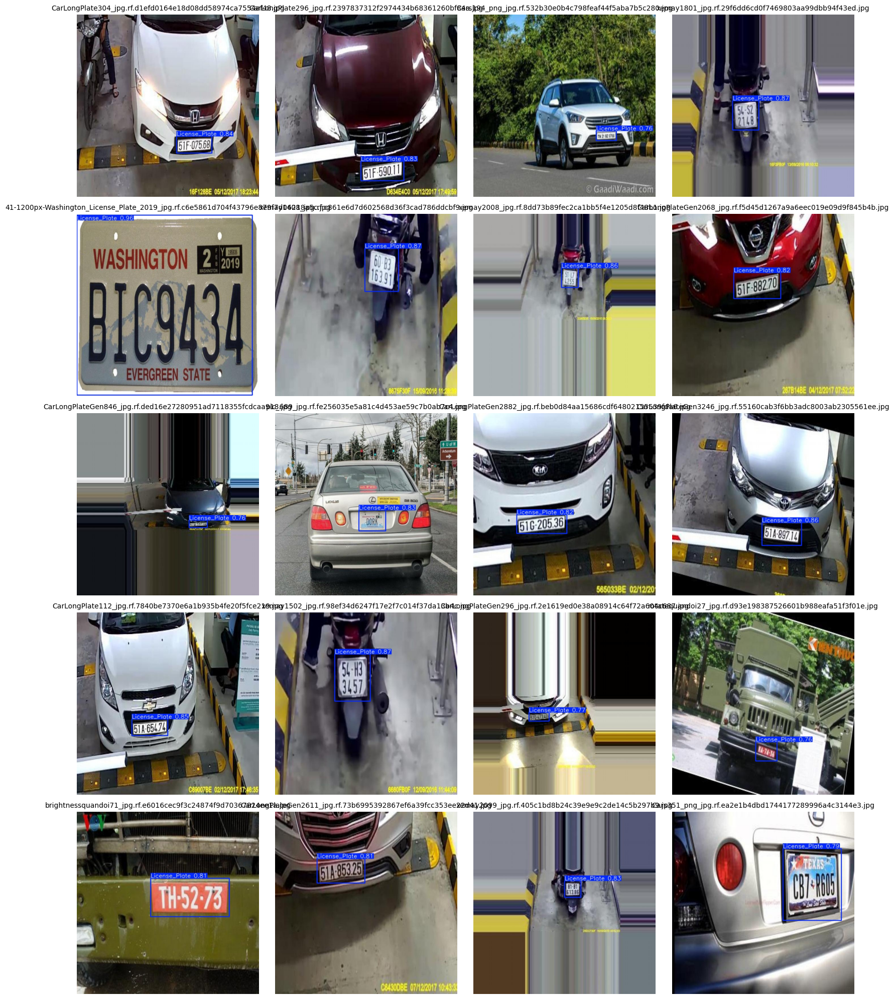

In [ ]:
rows, cols = 5, 4
plt.figure(figsize=(16, 20))

image_files = [f for f in os.listdir(path) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

for i in range(min(rows * cols, len(image_files))):
    img_path = os.path.join(path, image_files[i+25])
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    plt.subplot(rows, cols, i + 1)
    plt.imshow(img)
    plt.title(image_files[i+25], fontsize=10)
    plt.axis('off')

plt.tight_layout()
plt.show()

## Model Testing with Video

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving test_videos (1).rar to test_videos (1).rar


In [ ]:
!apt-get install unrar

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
unrar is already the newest version (1:6.1.5-1ubuntu0.1).
0 upgraded, 0 newly installed, 0 to remove and 35 not upgraded.


In [ ]:
!unrar x "/content/test_videos (1).rar"


UNRAR 6.11 beta 1 freeware      Copyright (c) 1993-2022 Alexander Roshal


Extracting from /content/test_videos (1).rar

Creating    test_videos                                               OK
Extracting  test_videos/2.mp4                                              6% 13% 19% 26% 33% 39% 42%  OK 
Extracting  test_videos/3.mp4                                             69% 95% 99%  OK 
All OK


In [ ]:
!ls /content/test_videos/

2.mp4  3.mp4


In [ ]:
model.predict(source="/content/test_videos/2.mp4",conf=0.5, save=True,project='predicted_videos',name='video_1')



WARNING ⚠️ 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/258) /content/test_videos/2.mp4: 384x640 1 License_Plate, 11.0ms
video 1/1 (frame 2/258) /content/test_videos/2.mp4: 384x640 1 License_Plate, 9.5ms
video 1/1 (frame 3/258) /content/test_videos/2.mp4: 384x640 1 License_Plate, 12.2ms
video 1/1 (frame 4/258) /content/test_videos/2.mp4: 384x640 1 License_Plate, 10.5ms
video 1/1 (frame 5/258) /content/test_videos/2.mp4: 384x640 1 License_Plate, 10.9ms
video 1/1 (frame 6/258) /content/test

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'License_Plate'}
 obb: None
 orig_img: array([[[178, 171, 168],
         [219, 212, 209],
         [248, 241, 238],
         ...,
         [241, 234, 231],
         [241, 234, 231],
         [241, 234, 231]],
 
        [[182, 175, 172],
         [223, 216, 213],
         [249, 242, 239],
         ...,
         [241, 234, 231],
         [241, 234, 231],
         [241, 234, 231]],
 
        [[193, 186, 183],
         [230, 223, 220],
         [251, 244, 241],
         ...,
         [241, 234, 231],
         [241, 234, 231],
         [241, 234, 231]],
 
        ...,
 
        [[107, 110, 110],
         [101, 104, 104],
         [102, 105, 105],
         ...,
         [131, 141, 145],
         [138, 148, 152],
         [141, 151, 155]],
 
        [[112, 115, 115],
         [102, 105, 105],
         [100, 103, 103],
         ...,
         [1

In [ ]:
!ffmpeg -i /content/predicted_videos/video_1/2.avi -vcodec libx264 /content/predicted_videos/video_1/2.mp4

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [ ]:
from IPython.display import Video
video1_path = '/content/predicted_videos/video_1/2.mp4'
display(Video(video1_path, embed=True, width=600))

In [ ]:
model.predict(source="/content/test_videos/3.mp4",conf=0.5, save=True,project='predicted_videos',name='video_2')


WARNING ⚠️ 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/721) /content/test_videos/3.mp4: 384x640 1 License_Plate, 465.3ms
video 1/1 (frame 2/721) /content/test_videos/3.mp4: 384x640 1 License_Plate, 12.0ms
video 1/1 (frame 3/721) /content/test_videos/3.mp4: 384x640 1 License_Plate, 11.9ms
video 1/1 (frame 4/721) /content/test_videos/3.mp4: 384x640 1 License_Plate, 12.3ms
video 1/1 (frame 5/721) /content/test_videos/3.mp4: 384x640 1 License_Plate, 10.5ms
video 1/1 (frame 6/721) /content/te

In [ ]:
!ffmpeg -i /content/predicted_videos/video_2/3.avi -vcodec libx264 /content/predicted_videos/video_1/3.mp4

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab